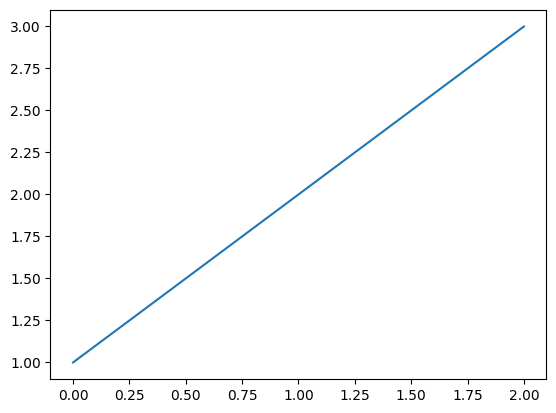

In [133]:
#!git clone https://github.com/Hong7Cong/RAFT_clone
import matplotlib.pyplot as plt
plt.plot([1, 2, 3])

In [134]:
import argparse
from timesformer.models.vit import MOOSE
import torch
parser = argparse.ArgumentParser()

parser.add_argument('--model', help="restore checkpoint")
parser.add_argument('--path', help="dataset for evaluation")
parser.add_argument('--small', action='store_true', help='use small model')
parser.add_argument('--mixed_precision', action='store_true', help='use mixed precision')
parser.add_argument('--alternate_corr', action='store_true', help='use efficent correlation implementation')
parser.add_argument('--MODEL.VISUAL_MODEL', type=str, default='default_model')
parser.add_argument('--MODEL.FUSION_MODE', type=str, default='concat')
parser.add_argument('--MODEL.NUM_CLASSES', type=int, default='400')
raft_args = parser.parse_args(['--model', 'RAFT_clone/model/raft-things.pth', 
                        '--path', 'New folder'])

from types import SimpleNamespace

cfg = SimpleNamespace(
    MODEL=SimpleNamespace(
        VISUAL_MODEL="dinov2",
        FUSION_MODE="biconcat",
        NUM_CLASSES=400
    ),
    DATA=SimpleNamespace(
        TRAIN_CROP_SIZE=224,
    )
)

model_infos = torch.load('C:\\Users\\hieuh\\Downloads\\project\\VideoMoose\\MOOSE-main\\moose_biconcat_8frames_diagmask_224_e9.pyth', weights_only=False, map_location='cpu')
model = MOOSE(cfg, raft_args)
model.load_state_dict(model_infos['model_state'], strict=False)
model.eval()

Using cache found in C:\Users\hieuh/.cache\torch\hub\facebookresearch_dinov2_main


MOOSE(
  (moose_encoder): MOOSE_Encoder(
    (motion_model): RAFT(
      (fnet): BasicEncoder(
        (norm1): InstanceNorm2d(64, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
        (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3))
        (relu1): ReLU(inplace=True)
        (layer1): Sequential(
          (0): ResidualBlock(
            (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            (relu): ReLU(inplace=True)
            (norm1): InstanceNorm2d(64, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
            (norm2): InstanceNorm2d(64, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
          )
          (1): ResidualBlock(
            (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), 

In [135]:
import av
import numpy as np
import torch
from IPython.core.pylabtools import figsize


def read_video_pyav(container, indices):
    '''
    Decode the video with PyAV decoder.
    Args:
        container (`av.container.input.InputContainer`): PyAV container.
        indices (`List[int]`): List of frame indices to decode.
    Returns:
        result (np.ndarray): np array of decoded frames of shape (num_frames, height, width, 3).
    '''
    frames = []
    container.seek(0)
    start_index = indices[0]
    end_index = indices[-1]
    for i, frame in enumerate(container.decode(video=0)):
        if i > end_index:
            break
        if i >= start_index and i in indices:
            frames.append(frame)
    return np.stack([x.to_ndarray(format="rgb24") for x in frames])


def sample_frame_indices(clip_len, frame_sample_rate):
    '''
    Sample a given number of frame indices from the video.
    Args:
        clip_len (`int`): Total number of frames to sample.
        frame_sample_rate (`int`): Sample every n-th frame.
        seg_len (`int`): Maximum allowed index of sample's last frame.
    Returns:
        indices (`List[int]`): List of sampled frame indices
    '''
    converted_len = int(clip_len * frame_sample_rate)
    start_idx = 10
    end_idx = start_idx + converted_len
    
    indices = np.linspace(start_idx, end_idx, num=clip_len)
    indices = np.clip(indices, start_idx, end_idx - 1).astype(np.int64)
    return indices

indices = sample_frame_indices(8, 8)
file_path = "visualize\\video1.mp4"
container = av.open(file_path)
indices

array([10, 19, 28, 37, 46, 55, 64, 73], dtype=int64)

In [136]:
#indices = [ 11,  34,  56,  79, 101, 124, 147, 169]
video = read_video_pyav(container, indices)

In [137]:
h = video[0].shape[0]
w = video[0].shape[1]
h, w

(480, 852)

In [138]:
# video_tensor.shape

In [139]:
import torch.nn.functional as F
import matplotlib.pyplot as plt
# def load_image_from_uint8array(img):
#     img = torch.from_numpy(img).permute(0, 3, 1, 2).float()
#     return img[None]

video_tensor = video[0]
video_tensor = torch.tensor(video).float()
# video_tensor = video_tensor.permute(0, 3, 1, 2)  # Shape: (num_frames, 3, height, width)
# video_tensor = video_tensor.unsqueeze(0)  # Shape: (1, num_frames, 3, height, width)
# video_tensor_resized = F.interpolate(video_tensor.view(-1, 3, video_tensor.shape[3], video_tensor.shape[4]), 
#                                      size=(224, 224), 
#                                      mode='bilinear', 
#                                      align_corners=False)

from torchvision import transforms
T = transforms.Compose([
    transforms.ToTensor(),
    transforms.Resize(size=(256, 320)),
    transforms.CenterCrop(224),
])
norm = transforms.Normalize((0.45, 0.45, 0.45), (0.225, 0.225, 0.225))
video_tensor_4plot = [T(vid) for vid in video]
video_tensor_resized = [norm(T(vid)) for vid in video]
video_tensor_resized =  torch.stack(video_tensor_resized)
video_tensor_4plot =  torch.stack(video_tensor_4plot)
# num_frames = 8
video_tensor_resized = video_tensor_resized.permute(1, 0, 2, 3).unsqueeze(0)
print("Resized Video tensor shape:", video_tensor_resized.shape)

Resized Video tensor shape: torch.Size([1, 3, 8, 224, 224])


(-0.5, 223.5, 223.5, -0.5)

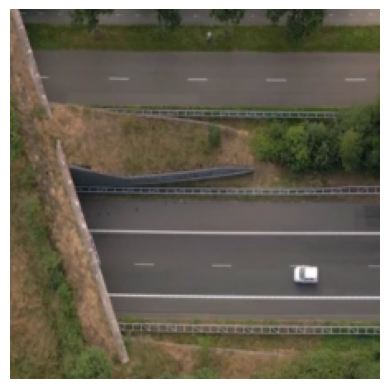

In [140]:
from PIL import Image
demo_array = np.moveaxis(video_tensor_4plot[0].numpy()*255, 0, -1)
# Image.fromarray(demo_array.astype(np.uint8))
plt.imshow(demo_array.astype(np.uint8))
plt.axis("off")

In [141]:
class Visualizer():
    def __init__(self, model):
        self.model = model
        self.hooks = []
        self.attn = []
        self.query = []
        self.key = []
        self.value = []
        
    def get_attn(self, module, input, output):
        self.attn.append(output.detach().cpu())
        
    def get_query(self, module, input, output):
        if isinstance(output, tuple):
            for out in output:
                if isinstance(out, torch.Tensor):
                    self.query.append(out.detach().cpu())
                else:
                    self.query.append(out)
        else:
            self.query.append(output.detach().cpu())
    
    def get_key(self, module, input, output):
        if isinstance(output, tuple):
            for out in output:
                if isinstance(out, torch.Tensor):
                    self.key.append(out.detach().cpu())
                else:
                    self.key.append(out)
        else:
            self.key.append(output.detach().cpu())
    
    def get_value(self, module, input, output):
        if isinstance(output, tuple):
            for out in output:
                if isinstance(out, torch.Tensor):
                    self.value.append(out.detach().cpu())
                else:
                    self.value.append(out)
        else:
            self.value.append(output.detach().cpu())
    
    def remove_hook(self):
        for h in self.hooks:
            h.remove()
        self.hooks = []
        
    def __call__(self, input):
        self.model.eval()
        self.attn = []
        with torch.no_grad():
            for name, m in self.model.named_modules():
                if f"moose_encoder.visual_model.blocks.11.attn.attn_drop" in name:
                    self.hooks.append(m.register_forward_hook(self.get_attn))
                    
                if "joint_cross_attn.to_qk" in name:
                    self.hooks.append(m.register_forward_hook(self.get_query))
                
                if "joint_cross_attn.context_to_qk" in name:
                    self.hooks.append(m.register_forward_hook(self.get_key))
                
                if  name == "motion_feature_extractor.blocks.11.attn.attn_drop":
                    self.hooks.append(m.register_forward_hook(self.get_value))
                
            _, last_attn, attn, attn_context, sim = self.model(input)
        self.remove_hook()
        return self.attn, last_attn, attn, attn_context, sim, self.query, self.key, self.value

In [142]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'
model = model.to(device)
video_tensor_resized = video_tensor_resized.to(device)
device

'cuda'

In [143]:
a = Visualizer(model)
attention, last_attn, attn, attn_context, sim, q, k,  V = a(video_tensor_resized)

torch.Size([1, 8, 257, 768])
torch.Size([1, 7, 2, 224, 224])
torch.Size([1, 7, 2, 224, 224])
torch.Size([7, 2, 224, 224])
torch.Size([7, 257, 768]) torch.Size([7, 257, 192])
torch.Size([1, 7, 257, 960])
torch.Size([1, 257, 960])


In [144]:
attn.shape

torch.Size([7, 8, 257, 257])

In [145]:
sim.shape

torch.Size([7, 8, 257, 257])

In [146]:
attention[0].shape

torch.Size([8, 12, 261, 261])

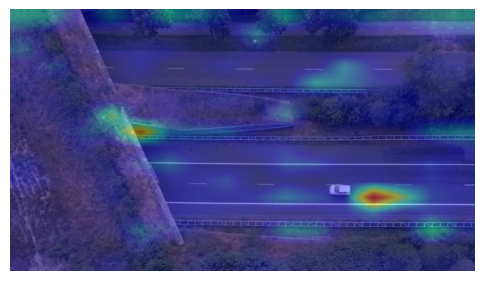

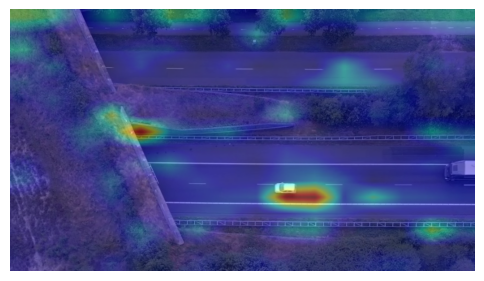

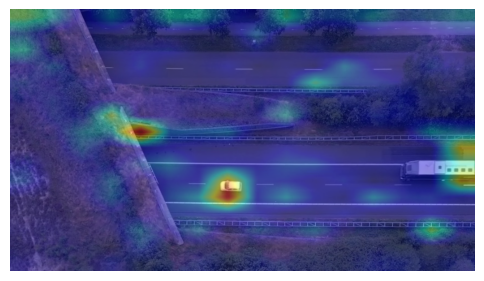

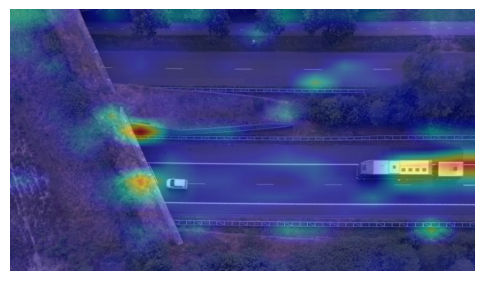

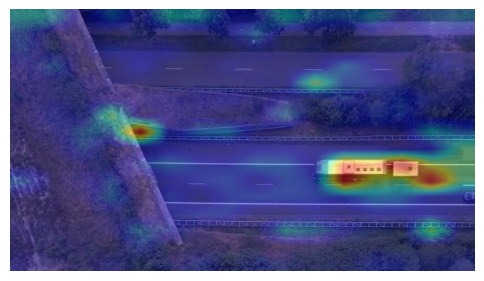

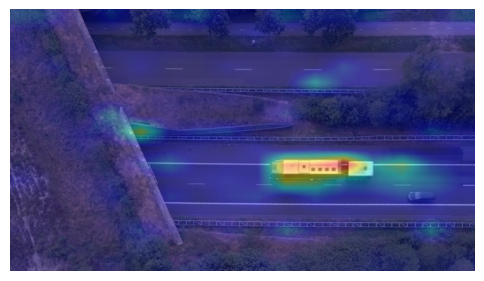

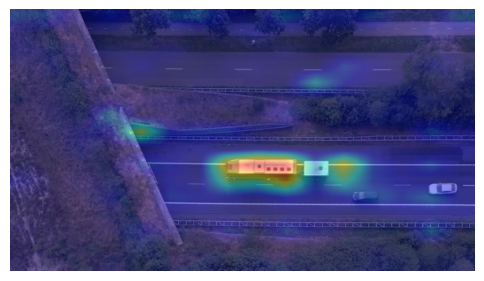

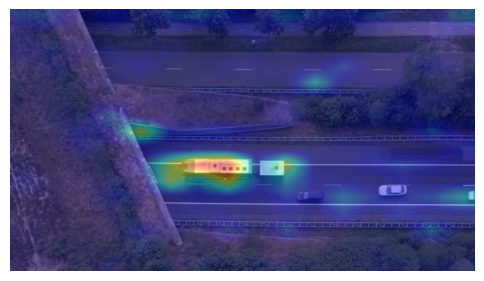

In [147]:
import torch
import torch.nn.functional as F
import numpy as np
import cv2
import matplotlib.pyplot as plt

for o in range(len(attention)):
    attn = attention[o].detach().cpu()  # shape: (B, num_heads, 197, 197)
    B, num_heads, seq_len, _ = attn.shape
    heatmaps = []
    top3_points_list = []

    for i in range(B):
        # Lấy attention của token CLS (index 0) đến các patch tokens (indices 1:197)
        # Kết quả có shape (num_heads, 196)
        attn_frame = attn[i, :, : 5 , 5:]
        attn_avg = attn_frame.mean(dim=0)
        attn_avg = attn_avg.mean(dim=0)
        # Chuẩn hóa attention về khoảng [0, 1]
        attn_norm = (attn_avg - attn_avg.min()) / (attn_avg.max() - attn_avg.min() + 1e-8)
        # Reshape thành lưới 14 x 14
        attn_grid = attn_norm.reshape(16, 16)
        attn_grid = attn_grid.unsqueeze(0).unsqueeze(0)
        # Phóng to (interpolate) lên kích thước 224 x 224
        attn_up = F.interpolate(attn_grid, size=(224, 224), mode="bilinear", align_corners=False)
        attn_up = attn_up.squeeze().numpy()  # shape: (224, 224)
        heatmaps.append(attn_up)

    overlay_images = []

    for i in range(B):
        frame = video[i]  # shape: (H, W, 3) (RGB)
        # Chuyển heatmap sang 8-bit [0, 255]
        heatmap = (heatmaps[i] * 255).astype(np.uint8)
        # Áp dụng colormap (COLORMAP_JET) cho heatmap
        heatmap_color = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)
        # Resize heatmap_color để khớp với kích thước của frame
        heatmap_color_resized = cv2.resize(heatmap_color, (frame.shape[1], frame.shape[0]))
        # Chuyển frame từ RGB sang BGR (theo chuẩn của OpenCV)
        frame_bgr = cv2.cvtColor(frame, cv2.COLOR_RGB2BGR)
        # Trộn ảnh gốc với heatmap
        overlay = cv2.addWeighted(frame_bgr, 0.6, heatmap_color_resized, 0.4, 0)

        overlay_images.append(overlay)

    # Hiển thị kết quả overlay cho từng frame
    for i in range(len(overlay_images)):
        plt.figure(figsize=(6, 6))
        plt.imshow(cv2.cvtColor(overlay_images[i], cv2.COLOR_BGR2RGB))
        plt.axis("off")
        plt.show()

In [148]:
# import torch
# import torch.nn.functional as F
# import numpy as np
# import cv2
# import matplotlib.pyplot as plt

# for o in range(len(K)):
#     attn = Q[o].detach().cpu()  # shape: (B, num_heads, 197, 197)
#     B, seq_len, _ = attn.shape
#     heatmaps = []

#     for i in range(B):
#         # Lấy Q của token CLS (index 0) đến các patch tokens (indices 1:197)
#         # Kết quả có shape (num_heads, 196)
#         attn_frame = attn[i, 0 , 1:]
#         # Tính trung bình Q qua các head -> shape: (196,)

#         # Chuẩn hóa Q về khoảng [0, 1]
#         attn_norm = (attn_frame - attn_frame.min()) / (attn_frame.max() - attn_frame.min() + 1e-8)
#         # Reshape thành lưới 14 x 14
#         attn_grid = attn_norm.reshape(16, 16)
#         attn_grid = attn_grid.unsqueeze(0).unsqueeze(0)
#         # Phóng to (interpolate) lên kích thước 224 x 224
#         attn_up = F.interpolate(attn_grid, size=(224, 224), mode="bilinear", align_corners=False)
#         attn_up = attn_up.squeeze().numpy()  # shape: (224, 224)
#         heatmaps.append(attn_up)

#     overlay_images = []

#     for i in range(B):
#         frame = video[i]  # shape: (H, W, 3) (RGB)
#         # Chuyển heatmap sang 8-bit [0, 255]
#         heatmap = (heatmaps[i] * 255).astype(np.uint8)
#         # Áp dụng colormap (COLORMAP_JET) cho heatmap
#         heatmap_color = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)
#         # Resize heatmap_color để khớp với kích thước của frame
#         heatmap_color_resized = cv2.resize(heatmap_color, (frame.shape[1], frame.shape[0]))
#         # Chuyển frame từ RGB sang BGR (theo chuẩn của OpenCV)
#         frame_bgr = cv2.cvtColor(frame, cv2.COLOR_RGB2BGR)
#         # Trộn ảnh gốc với heatmap
#         overlay = cv2.addWeighted(frame_bgr, 0.6, heatmap_color_resized, 0.4, 0)

#         overlay_images.append(overlay)

#     # Hiển thị kết quả overlay cho từng frame
#     for i in range(len(overlay_images)):
#         plt.figure(figsize=(6, 6))
#         plt.imshow(cv2.cvtColor(overlay_images[i], cv2.COLOR_BGR2RGB))
#         plt.axis("off")
#         plt.show()

In [149]:
attention_weights = []
for i in range(len(q)):
    q_temp = q[i]  # shape: [1, 197, 768]
    k_temp = k[i]  # shape: [1, 197, 768]

    scale = q_temp.size(-1)**0.5
    att_weight = q_temp@k_temp.transpose(-2, -1) / scale
    att_weight = F.softmax(att_weight, dim=-1)
    attention_weights.append(att_weight)

In [150]:
attention_weights[0].shape

torch.Size([7, 257, 257])

In [151]:
temp = attention_weights[0]
temp = torch.mean(temp, axis=0)
temp = torch.unsqueeze(temp, 0)
attention_weights[0] = torch.cat((attention_weights[0], temp), dim=0)
attention_weights[0].shape

torch.Size([8, 257, 257])

In [152]:
t = attention_weights[0][1, 0, 1:]
t.shape

torch.Size([256])

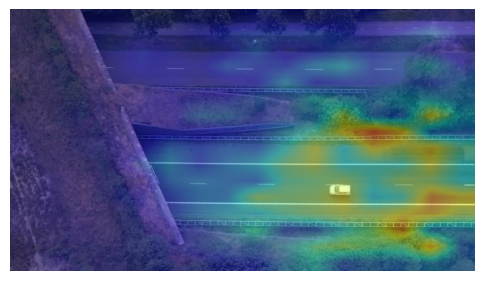

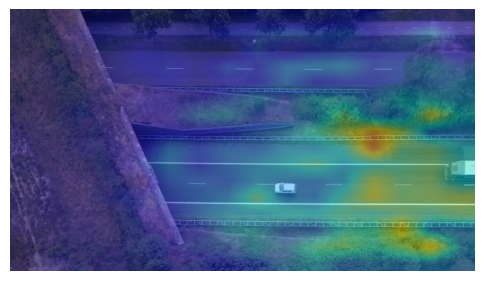

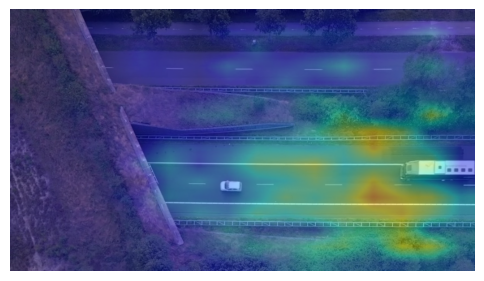

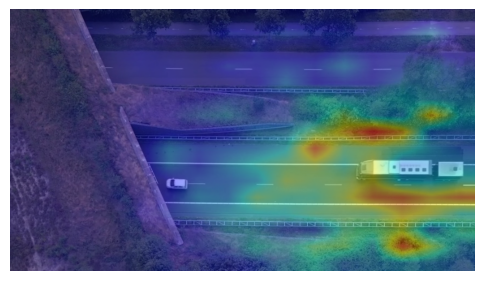

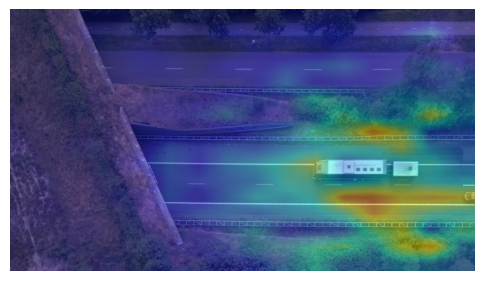

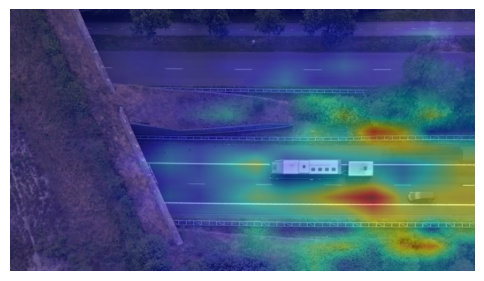

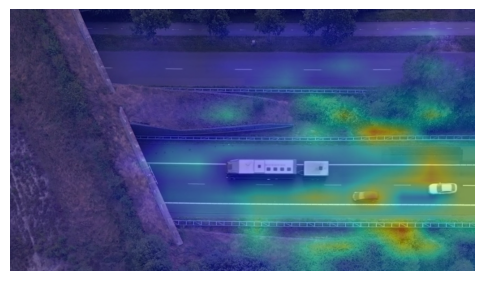

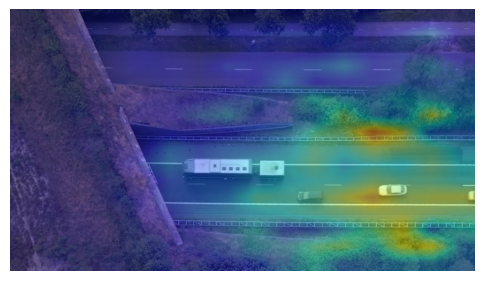

In [153]:
import cv2
import matplotlib.pyplot as plt

overlay_images = []
hm = []

for o in range (len(attention_weights)):
    attn = attention_weights[o].detach().cpu()  # shape: (B, num_heads, 197, 197)
    B, seq_len, _ = attn.shape
    heatmaps = []
    
    for i in range(B):
        attn_avg = attn[i, 1:, 0]
        attn_norm = (attn_avg - attn_avg.min()) / (attn[:, 1:, 0].max() - attn[:, 1:, 0].min() + 1e-8)#[Hong Modify]
        # Reshape thành lưới 14 x 14
        attn_grid = attn_norm.reshape(16, 16)
        attn_grid = attn_grid.unsqueeze(0).unsqueeze(0)
        # Phóng to (interpolate) lên kích thước 224 x 224
        attn_up = F.interpolate(attn_grid, size=(224, 224), mode="bilinear", align_corners=False)
        attn_up = attn_up.squeeze().numpy()  # shape: (224, 224)
        heatmaps.append(attn_up)
    
    for i in range(B):
        temp = np.moveaxis(video_tensor_4plot[i].cpu().numpy()*255, 0, -1).astype(np.uint8)
        frame =  video[i]  # shape: (H, W, 3) (RGB)
        # Chuyển heatmap sang 8-bit [0, 255]
        heatmap = (heatmaps[i] * 255).astype(np.uint8)
        # Áp dụng colormap (COLORMAP_JET) cho heatmap
        heatmap_color = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)
        # Resize heatmap_color để khớp với kích thước của frame
        heatmap_color_resized = cv2.resize(heatmap_color, (frame.shape[1], frame.shape[0]))
        hm.append(heatmap_color_resized)
        # Chuyển frame từ RGB sang BGR (theo chuẩn của OpenCV)
        frame_bgr = cv2.cvtColor(frame, cv2.COLOR_RGB2BGR)
        # Trộn ảnh gốc với heatmap
        overlay = cv2.addWeighted(frame_bgr, 0.6, heatmap_color_resized, 0.4, 0)
        
        # Vẽ lên overlay 3 điểm mà CLS token chú ý nhiều nhất
        # Vì lưới gốc là 14x14, mỗi ô có kích thước tương ứng với: 224/14 = 16 (trong không gian heatmap 224x224)
        # Ta cần scale tọa độ từ không gian 224x224 sang kích thước frame (overlay) hiện tại.
        # Tính tỉ lệ scale dựa trên frame kích thước (giả sử heatmap ban đầu có kích thước 224x224)
        scale_x = frame.shape[1] / 224.0
        scale_y = frame.shape[0] / 224.0
        factor = 224 / 14.0  # kích thước mỗi ô trên heatmap 224x224
        overlay_images.append(overlay)
    
    # Hiển thị kết quả overlay cho từng frame
for i in range(len(overlay_images)):
    plt.figure(figsize=(6, 6))
    plt.imshow(cv2.cvtColor(cv2.resize(overlay_images[i], (video[i].shape[1], video[i].shape[0])), cv2.COLOR_BGR2RGB))
    plt.axis("off")
    plt.show()

In [154]:
t = attn[:, 1:, 0]
t.shape

torch.Size([8, 256])

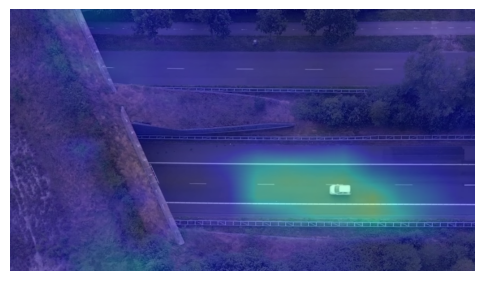

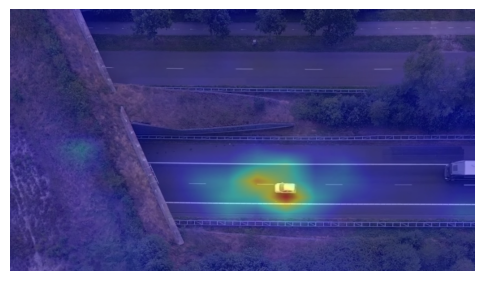

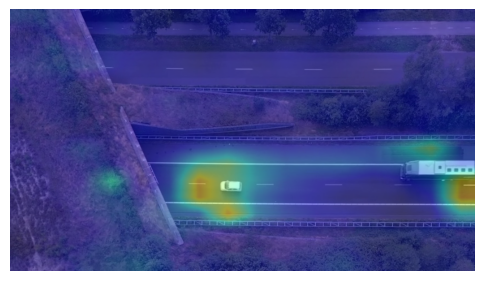

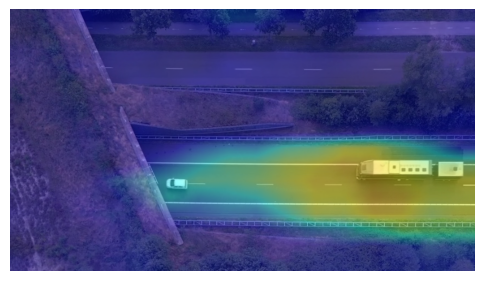

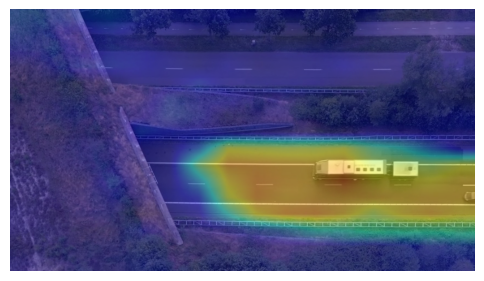

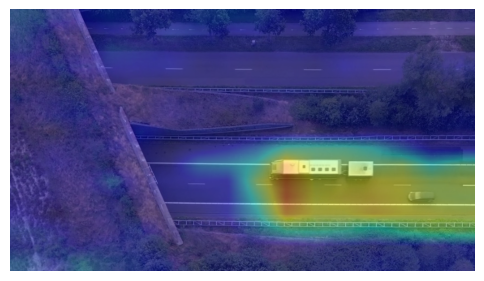

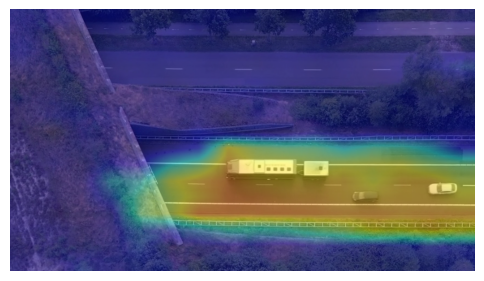

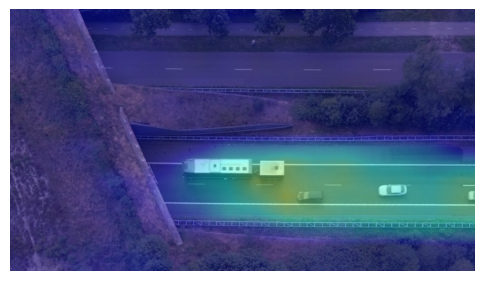

In [155]:
import cv2
import matplotlib.pyplot as plt

overlay_images = []
hm = []

for o in range (len(attention_weights)):
    attn = attention_weights[o].detach().cpu()  # shape: (B, num_heads, 197, 197)
    B, seq_len, _ = attn.shape
    heatmaps = []
    
    for i in range(B):
        # Lấy attention của token CLS (index 0) đến các patch tokens (indices 1:197)
        # Kết quả có shape (num_heads, 196)
        attn_avg = attn[i, 0, 1:]
        # Tính trung bình attention qua các head -> shape: (196,)
        
        # Chuẩn hóa attention về khoảng [0, 1]
        attn_norm = (attn_avg - attn_avg.min()) / (attn[:, 0, 1:].max() - attn[:, 0, 1:].min() + 1e-8)#[Hong Modify]
        # Reshape thành lưới 14 x 14
        attn_grid = attn_norm.reshape(16, 16)
        attn_grid = attn_grid.unsqueeze(0).unsqueeze(0)
        # Phóng to (interpolate) lên kích thước 224 x 224
        attn_up = F.interpolate(attn_grid, size=(224, 224), mode="bilinear", align_corners=False)
        attn_up = attn_up.squeeze().numpy()  # shape: (224, 224)
        heatmaps.append(attn_up)
    
    for i in range(B):
        temp = np.moveaxis(video_tensor_4plot[i].cpu().numpy()*255, 0, -1).astype(np.uint8)
        frame =  video[i]  # shape: (H, W, 3) (RGB)
        # Chuyển heatmap sang 8-bit [0, 255]
        heatmap = (heatmaps[i] * 255).astype(np.uint8)
        # Áp dụng colormap (COLORMAP_JET) cho heatmap
        heatmap_color = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)
        # Resize heatmap_color để khớp với kích thước của frame
        heatmap_color_resized = cv2.resize(heatmap_color, (frame.shape[1], frame.shape[0]))
        hm.append(heatmap_color_resized)
        # Chuyển frame từ RGB sang BGR (theo chuẩn của OpenCV)
        frame_bgr = cv2.cvtColor(frame, cv2.COLOR_RGB2BGR)
        # Trộn ảnh gốc với heatmap
        overlay = cv2.addWeighted(frame_bgr, 0.6, heatmap_color_resized, 0.4, 0)
        
        # Vẽ lên overlay 3 điểm mà CLS token chú ý nhiều nhất
        # Vì lưới gốc là 14x14, mỗi ô có kích thước tương ứng với: 224/14 = 16 (trong không gian heatmap 224x224)
        # Ta cần scale tọa độ từ không gian 224x224 sang kích thước frame (overlay) hiện tại.
        # Tính tỉ lệ scale dựa trên frame kích thước (giả sử heatmap ban đầu có kích thước 224x224)
        scale_x = frame.shape[1] / 224.0
        scale_y = frame.shape[0] / 224.0
        factor = 224 / 14.0  # kích thước mỗi ô trên heatmap 224x224
        overlay_images.append(overlay)
    
    # Hiển thị kết quả overlay cho từng frame
for i in range(len(overlay_images)):
    plt.figure(figsize=(6, 6))
    plt.imshow(cv2.cvtColor(cv2.resize(overlay_images[i], (video[i].shape[1], video[i].shape[0])), cv2.COLOR_BGR2RGB))
    plt.axis("off")
    plt.show()

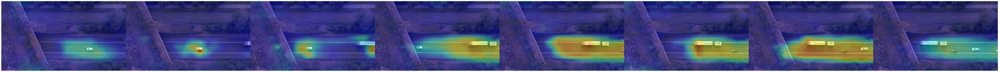

In [156]:
t = np.hstack(overlay_images)
plt.figure(figsize=(100, 100))
plt.imshow(cv2.cvtColor(t, cv2.COLOR_BGR2RGB))
plt.axis("off")
plt.show()

In [157]:
from torchvision.transforms import functional as FS
from torchvision.models.optical_flow import raft_large
import torch
import numpy as np
import cv2
import matplotlib.pyplot as plt

def compute_optical_flow(frame1, frame2, model, device):
    # Convert frames to tensors and move them to the device
    frame1_tensor = FS.to_tensor(frame1).unsqueeze(0).to(device)  # Shape: [1, 3, H, W]
    frame2_tensor = FS.to_tensor(frame2).unsqueeze(0).to(device)  # Shape: [1, 3, H, W]

    # Resize frames to be divisible by 8
    _, _, h, w = frame1_tensor.shape
    h = (h // 8) * 8
    w = (w // 8) * 8
    frame1_tensor = FS.resize(frame1_tensor, (h, w))
    frame2_tensor = FS.resize(frame2_tensor, (h, w))

    # Perform inference
    with torch.no_grad():
        flow = model(frame1_tensor, frame2_tensor)[0]  # Shape: [1, 2, H, W]

    # Process the flow result: remove batch dimension and permute to [H, W, 2]
    flow = flow[0].permute(1, 2, 0).cpu().numpy()
    return flow

def visualize_optical_flow_arrow(optical_flow, start_frame, scale, motion_attn=None):
    # optical_flow có shape [H_flow, W_flow, 2]
    flow = np.array(optical_flow)

    # Lấy kích thước của ảnh gốc (start_frame)
    orig_h, orig_w = start_frame.shape[:2]
    flow_h, flow_w, _ = flow.shape

    # Nếu kích thước của optical flow khác với ảnh gốc, resize và scale lại vector flow
    if (orig_h, orig_w) != (flow_h, flow_w):
        # Tính hệ số tỷ lệ theo chiều dọc và ngang
        scale_y = orig_h / flow_h
        scale_x = orig_w / flow_w
        
        # Resize từng kênh của flow và nhân hệ số tương ứng
        resized_flow = np.zeros((orig_h, orig_w, 2), dtype=np.float32)
        resized_flow[..., 0] = cv2.resize(flow[..., 0], (orig_w, orig_h), interpolation=cv2.INTER_LINEAR) * scale_x
        resized_flow[..., 1] = cv2.resize(flow[..., 1], (orig_w, orig_h), interpolation=cv2.INTER_LINEAR) * scale_y
        flow = resized_flow

    # Tạo một bản sao của start_frame để vẽ arrow
    vis_frame_with_arrows = start_frame.copy()
    # Nếu ảnh start_frame là RGB, chuyển sang BGR để dùng OpenCV
    vis_frame_with_arrows = cv2.cvtColor(vis_frame_with_arrows, cv2.COLOR_RGB2BGR)

    # Nếu có motion_attn, xử lý và overlay lên ảnh (đảm bảo kích thước khớp)
    if motion_attn is not None:
        # Resize motion_attn về kích thước của ảnh nếu cần
        if motion_attn.shape[:2] != (orig_h, orig_w):
            motion_attn = cv2.resize(motion_attn, (orig_w, orig_h))
        # Nếu motion_attn là grayscale, chuyển sang 3 kênh
        if len(motion_attn.shape) == 2 or (len(motion_attn.shape) == 3 and motion_attn.shape[2] == 1):
            motion_attn = cv2.cvtColor(motion_attn, cv2.COLOR_GRAY2BGR)
        # Áp dụng colormap nếu cần (ở đây sử dụng COLORMAP_JET)
        motion_color = cv2.applyColorMap(cv2.convertScaleAbs(motion_attn), cv2.COLORMAP_JET)
        vis_frame_with_arrows = cv2.addWeighted(vis_frame_with_arrows, 0.6, motion_color, 0.4, 0)

    # Lấy kích thước mới của optical flow (đã resize về kích thước của ảnh gốc)
    H, W, _ = flow.shape

    # Vẽ các mũi tên thể hiện optical flow trên ảnh
    for y in range(0, H, 50):  # Lấy mẫu mỗi 12 pixel
        for x in range(0, W, 50):
            dx, dy = flow[y, x]  # Flow vector tại (x, y)
            start_point = (x, y)
            end_point = (int(x + scale * dx), int(y + scale * dy))
            cv2.arrowedLine(vis_frame_with_arrows, start_point, end_point, (255, 255, 255), thickness=2, tipLength=0.2)
    
    # Chuyển đổi ảnh từ BGR về RGB để hiển thị với Matplotlib
    vis_frame_with_arrows_rgb = cv2.cvtColor(vis_frame_with_arrows, cv2.COLOR_BGR2RGB)
    plt.figure(figsize=(6, 6))
    plt.imshow(vis_frame_with_arrows_rgb)
    plt.axis("off")
    plt.show()
    return vis_frame_with_arrows_rgb

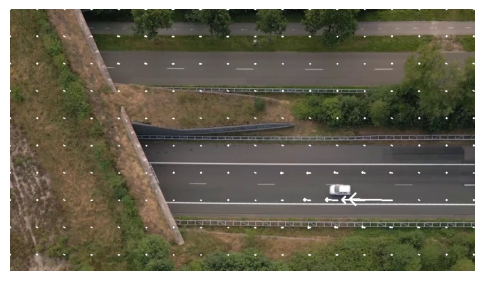

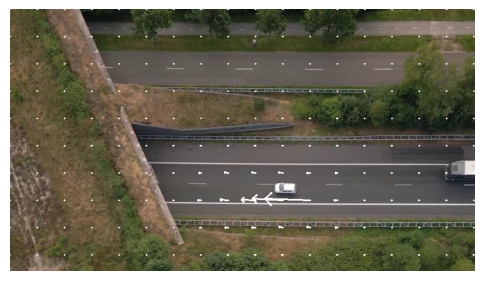

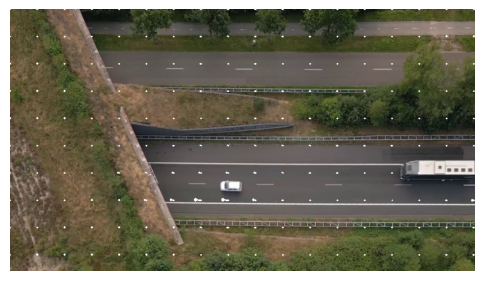

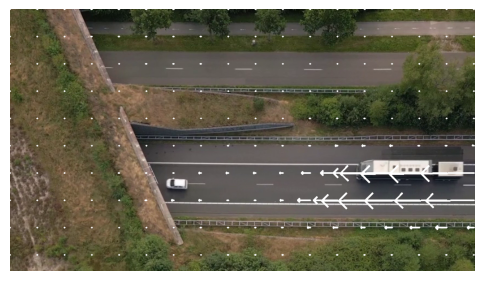

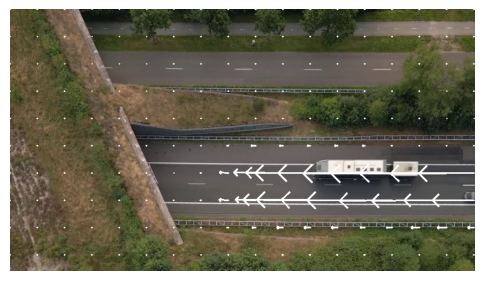

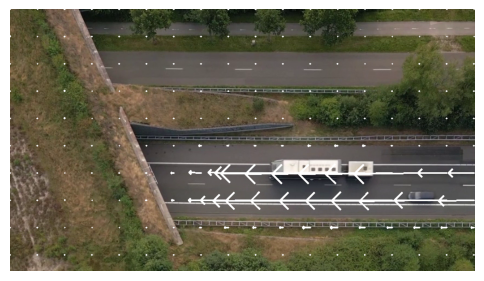

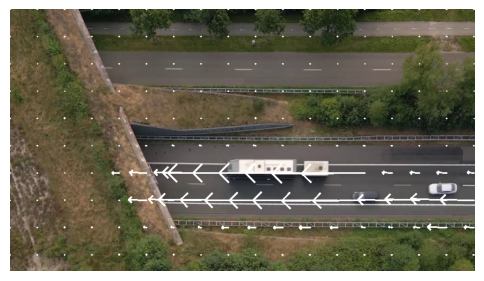

In [158]:
raft = raft_large(pretrained=True, progress=True).eval().to(device)  # Load raft_large model

frames = []
for i in range(len(video)):
    frames.append(np.moveaxis(video_tensor_4plot[i].cpu().numpy()*255, 0, -1).astype(np.uint8))
for i in range(len(video) - 1):
    # frame = np.moveaxis(video_tensor_4plot[i].cpu().numpy()*255, 0, -1).astype(np.uint8)
    flow = compute_optical_flow(frames[i], frames[i + 1], raft, device)
    visualize_optical_flow_arrow(flow, video[i], scale=1)

In [159]:
v = V[0]
v[0][0].shape

torch.Size([257, 257])

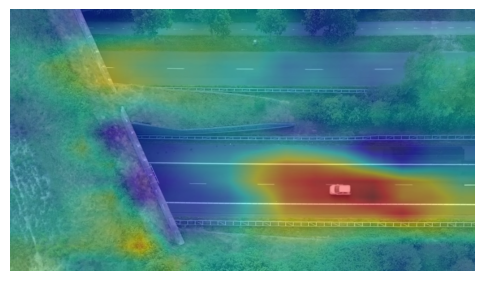

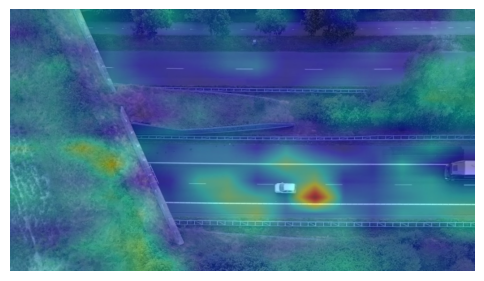

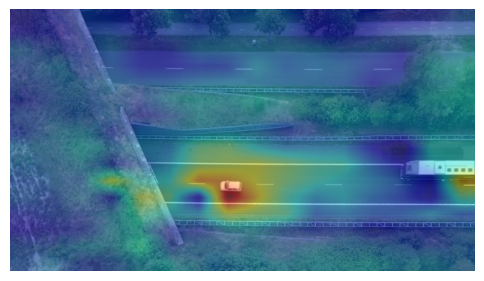

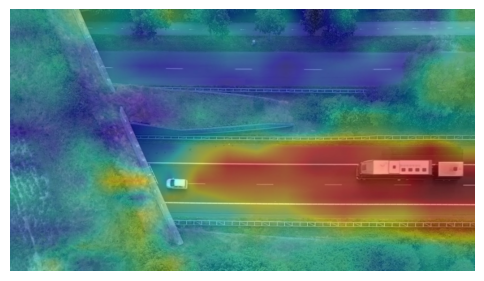

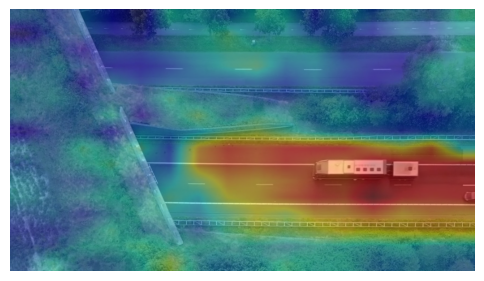

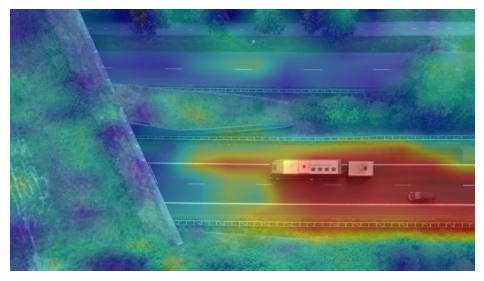

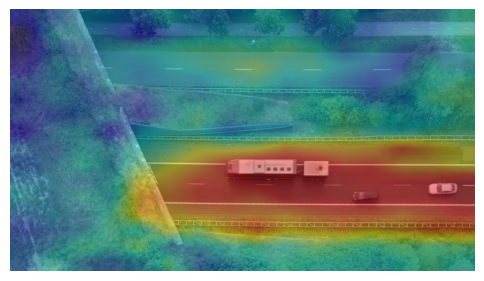

In [160]:
motion_attn = []
import torch.nn.functional as F
for o in range(7):
    attn = v[o].detach().cpu()  # shape: (B, num_heads, 197, 197)
    attn = attn[0]
    attn_frame = attn[1:, 0]
    attn_avg = attn_frame
    attn_norm = (attn_avg - attn_avg.min()) / (attn[1:, 0].max() - attn[1:, 0].min() + 1e-8)#[Hong Modify]
    # Reshape thành lưới 14 x 14
    attn_grid = attn_norm.reshape(16, 16)
    attn_grid = attn_grid.unsqueeze(0).unsqueeze(0)
    # Phóng to (interpolate) lên kích thước 224 x 224
    attn_up = F.interpolate(attn_grid, size=(224, 224), mode="bilinear", align_corners=False)
    attn_up = attn_up.squeeze().numpy()  # shape: (224, 224)

    frame = frames[o + 1]  # shape: (H, W, 3) (RGB)
    heatmap = (attn_up * 255).astype(np.uint8)
    motion_attn.append(heatmap)
    # Áp dụng colormap (COLORMAP_JET) cho heatmap
    heatmap_color = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)
    # Resize heatmap_color để khớp với kích thước của frame
    heatmap_color_resized = cv2.resize(heatmap_color, (w, h))
    # Chuyển frame từ RGB sang BGR (theo chuẩn của OpenCV)
    frame_bgr = cv2.cvtColor(video[o], cv2.COLOR_RGB2BGR)
    overlay = cv2.addWeighted(frame_bgr, 0.6, heatmap_color_resized, 0.4, 0)
    
    plt.figure(figsize=(6, 6))
    plt.imshow(cv2.cvtColor(overlay, cv2.COLOR_BGR2RGB))
    plt.axis("off")
    plt.show()

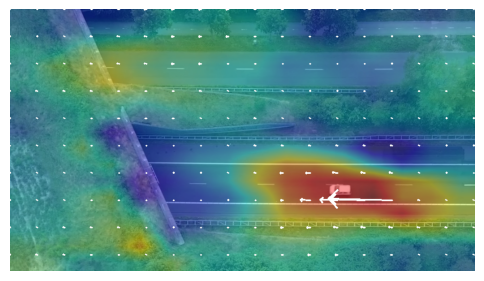

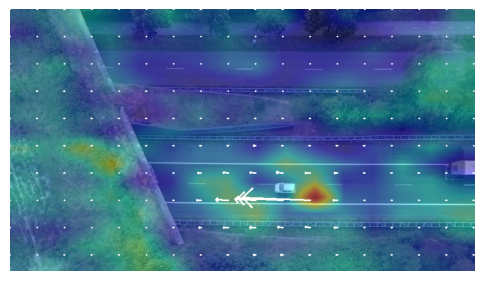

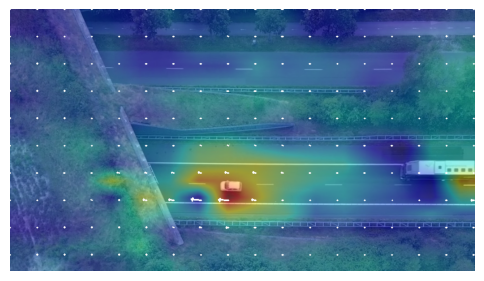

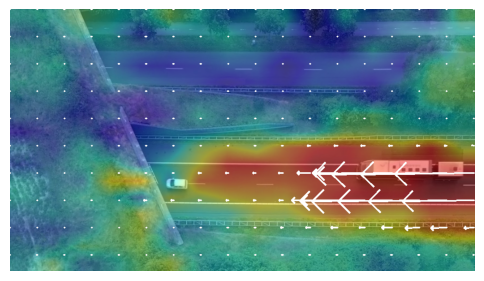

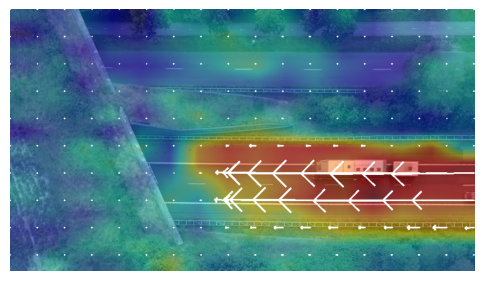

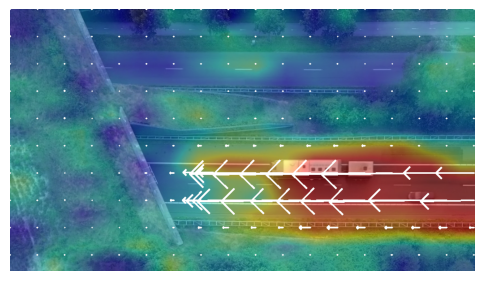

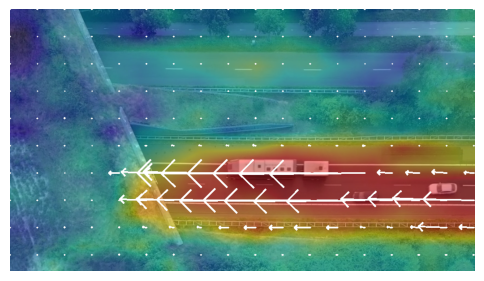

In [161]:
frames = []
viz = []
for i in range(len(video)):
    frames.append(np.moveaxis(video_tensor_4plot[i].cpu().numpy()*255, 0, -1).astype(np.uint8))
for i in range(len(video) - 1):
    flow = compute_optical_flow(frames[i], frames[i + 1], raft, device)
    t = visualize_optical_flow_arrow(flow, video[i], scale=1.5, motion_attn= motion_attn[i])
    viz.append(t)

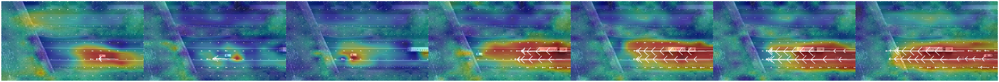

In [162]:
viz = np.hstack(viz)
plt.figure(figsize=(100, 100))
plt.imshow(viz)
plt.axis("off")
plt.show()

In [163]:
# top_query = np.array(topk_indices)
# query = torch.tensor(top_query, dtype=torch.long)
# query

In [164]:
# attn1 = attention_weights[-1][:, 1:, 1:]
# attn1 = attn1[0, query, :]
# max_val, idx_ = attn1.max(dim=-1)
# idx_ = idx_.cpu().numpy()
# idx_

In [165]:
# model_input_size = (224, 224) 
# patch_grid_size = 14
# patch_size_model = model_input_size[0] // patch_grid_size 
# 
# def compute_patch_centers(token_indices, grid_size=14, patch_size=16):
#     centers = []
#     for idx in token_indices:
#         row = idx // grid_size
#         col = idx % grid_size
#         x = int(col * patch_size + patch_size / 2)
#         y = int(row * patch_size + patch_size / 2)
#         centers.append((x, y))
#     return np.array(centers)

In [166]:
# key = compute_patch_centers(idx_)
# query = compute_patch_centers(topk_indices)

In [167]:
# actual_height, actual_width = video[0].shape[:2]
# scale_x = actual_width / model_input_size[0]
# scale_y = actual_height / model_input_size[1]

In [168]:
# def scale_coordinates(centers, scale_x, scale_y):
#     scaled = []
#     for (x, y) in centers:
#         x_scaled = int(x * scale_x)
#         y_scaled = int(y * scale_y)
#         scaled.append((x_scaled, y_scaled))
#     return np.array(scaled)

In [169]:
# key = scale_coordinates(key, scale_x, scale_y)
# query = scale_coordinates(query, scale_x, scale_y)

In [170]:
# frame_querry = overlay_images[0]
# frame_key = cv2.imread("New folder/1.jpg")
# frame_key = cv2.resize(frame_key, (852, 480))

In [171]:
# combined_frame = np.hstack((frame_querry, frame_key))
# overlay = combined_frame.copy()
# offset_x = frame_querry.shape[1]
# cmap = plt.get_cmap('tab10')
# colors = [tuple(int(255 * x) for x in cmap(i)[:3]) for i in range(len(key))]

In [172]:
# for i, (pt1, pt2) in enumerate(zip(query , key)):
#     pt1_int = (int(pt1[0]), int(pt1[1]))
#     pt2_int = (int(pt2[0] + offset_x), int(pt2[1]))
#     color = colors[i]
#     cv2.circle(overlay, pt1_int, radius=8, color=color, thickness=-1)
#     cv2.circle(overlay, pt2_int, radius=8, color=color, thickness=-1)
#     cv2.line(overlay, pt1_int, pt2_int, color=color, thickness=2)

In [173]:
# plt.figure(figsize=(12, 6))
# plt.imshow(cv2.cvtColor(overlay, cv2.COLOR_BGR2RGB))
# plt.axis("off")
# plt.show()

In [174]:
# import numpy as np
# import av
# 
# def get_frames(path_to_video, num_frames=8):
#     "Trích xuất 10 frame đầu của video và resize về 1024x436, trả về mảng các chỉ số frame"
# 
#     # Nếu đầu vào là file video với định dạng được hỗ trợ
#     if path_to_video.is_file() and path_to_video.suffix in ['.mp4', '.avi', '.mov']:
#         # Tạo thư mục chứa các frame được trích xuất
#         frames_dir = path_to_video.parent / (path_to_video.stem + '_frames')
#         frames_dir.mkdir(exist_ok=True)
# 
#         # Trích xuất frame sử dụng PyAV, chỉ lấy 10 frame đầu
#         with av.open(str(path_to_video)) as container:
#             stream = container.streams.video[0]
#             for i, frame in enumerate(container.decode(stream)):
#                 frame_path = frames_dir / f'{i:06d}.jpg'  # Lưu frame dưới dạng JPG với tên file có định dạng 6 chữ số
#                 pil_img = frame.to_image()               # chuyển đổi thành PIL Image
#                 pil_img = pil_img.resize((1024, 436))      # resize về 1024x436
#                 pil_img.save(frame_path)
# 
#         # Lấy danh sách các frame đã lưu và sắp xếp theo thứ tự dựa trên chỉ số trong tên file
#         path_to_frames = list(frames_dir.iterdir())
#         path_to_frames.sort(key=lambda f: int(f.with_suffix('').name[-6:]))
#     else:
#         # Nếu đầu vào không phải file video, giả định đó là thư mục chứa frame
#         path_to_frames = list(path_to_video.iterdir())
#         path_to_frames.sort(key=lambda f: int(f.with_suffix('').name[-6:]))
# 
#     # Kiểm tra số lượng frame có đủ cho số lượng cần lấy mẫu không
#     assert num_frames <= len(path_to_frames), "num_frames can't exceed the number of frames extracted from video"
# 
#     # Nếu số lượng frame trích xuất đúng bằng num_frames thì trả về mảng các chỉ số [0, 1, ..., num_frames-1]
#     if len(path_to_frames) == num_frames:
#         return np.arange(num_frames)
#     else:
#         video_length = len(path_to_frames)
#         seg_size = float(video_length - 1) / num_frames
#         seq = []
#         for i in range(num_frames):
#             start = int(np.round(seg_size * i))
#             end = int(np.round(seg_size * (i + 1)))
#             seq.append((start + end) // 2)
#         return np.array(seq)


In [175]:
# from pathlib import Path
# path_to_video = Path("C:\\Users\\hieuh\\Downloads\\móoe\\video.mp4")
# path_to_video.exists()
# a = get_frames(path_to_video)

In [176]:
# !python RAFT_clone/demo.py --model=RAFT_clone/model/raft-things.pth --path="New folder"